**Library Import**

In [1]:
!pip install -Uqq fastbook
import fastbook
fastbook.setup_book()

/Users/i.p.kruyt/opt/anaconda3/lib/python3.7/site-packages/fastbook/__init__.py:18: UserWarning: Missing `graphviz` - please run `conda install fastbook`
  except ModuleNotFoundError: warn("Missing `graphviz` - please run `conda install fastbook`")


In [2]:
from fastbook import *
from fastai.vision.widgets import *

In [3]:
from time import sleep
import matplotlib.image as mpimg
import numpy as np
import matplotlib.pyplot as plt
import scipy
import pandas as pd
from selenium import webdriver
import imageio
import shutil



***Making the class for entering website, logging in, liking and saving pictures.***

In [5]:
class TinderBot():
    def __init__(self):
        self.driver = webdriver.Chrome(r'/usr/local/bin/chromedriver')
        self.driver.maximize_window()
        # Open site and wait to load
        self.driver.get('https://www.badoo.com')

    def login(self):
        # Login process
        self.driver.implicitly_wait(5)
        login_btn = self.driver.find_element_by_xpath('//*[@id="header"]/div/div[2]/div/div/a')
        login_btn.click()
        email_in = self.driver.find_element_by_xpath(
            '//*[@id="page"]/div[1]/div[3]/section/div/div/div[1]/form/div[1]/div[2]/div/input')
        email_in.send_keys("itsekruyt@hotmail.com")
        pw_in = self.driver.find_element_by_xpath(
            '//*[@id="page"]/div[1]/div[3]/section/div/div/div[1]/form/div[2]/div[2]/div/input')
        # Enter password
        pw_in.send_keys("Badooww02")
        login_btn = self.driver.find_element_by_xpath(
            '//*[@id="page"]/div[1]/div[3]/section/div/div/div[1]/form/div[5]/div/div[1]/button')
        login_btn.click()

    def retrieve_image(self, name):
        # Retrieve Image
        self.driver.implicitly_wait(30)
        image_src = self.driver.find_element_by_xpath(
            '//*[@id="mm_cc"]/div[1]/section/div/div[1]/div/div[1]/img').get_attribute('src')
        driver = webdriver.Chrome(r'/usr/local/bin/chromedriver')
        driver.get(image_src)

        # Get the dimensions of the browser and image.
        orig_h = driver.execute_script('return window.outerHeight')
        orig_w = driver.execute_script('return window.outerWidth')
        margin_h = orig_h - driver.execute_script('return window.innerHeight')
        margin_w = orig_w - driver.execute_script('return window.innerWidth')
        new_h = driver.execute_script('return document.getElementsByTagName("img")[0].height')
        new_w = driver.execute_script('return document.getElementsByTagName("img")[0].width')

        # Resize the browser window.
        driver.set_window_size(new_w + margin_w, new_h + margin_h)

        # Get the image by taking a screenshot of the page.
        img_val = driver.get_screenshot_as_file(f"/users/i.p.kruyt/pycharmprojects/badoo_photo_database/{name}.png")
        
        driver.close()
        return img_val

    def like(self):
        self.driver.implicitly_wait(30)
        like_button = self.driver.find_element_by_xpath(
            '//*[@id="mm_cc"]/div[1]/section/div/div[2]/div/div[2]/div[1]/div[1]')
        like_button.click()
   
    def dislike(self):
        self.driver.implicitly_wait(30)
        dislike_button = self.driver.find_element_by_xpath(
            '//*[@id="mm_cc"]/div[1]/section/div/div[2]/div/div[2]/div[2]/div[1]')
        dislike_button.click()

    def skip_firstlike(self):
        self.driver.implicitly_wait(5)
        try:        #if popup
            overslaan = self.driver.find_element_by_xpath('//*[@id="btn btn--monochrome js-chrome-pushes-deny"]/html/body/aside/section/div[1]/div/div/section/div/div/div/div[2]/div')
            overslaan.click()
        except:      #If matched
            self.driver.refresh()

    def end(self):
        self.close()
        
    

**DATASET CREATION**

**Image Folder Creation**

In [6]:
###THE SCRIPT
TBot = TinderBot()

#First we log in
TBot.login()


In [91]:
##Liking and scraping
#Change range to desired dataset size
for x in range(1001,1201):
    try:
        TBot.retrieve_image("photo" + str(x))    
        TBot.like()
    #Remove pop-up
    except:
        TBot.skip_firstlike()


**Labeler**

In [92]:
labels = []
images = []

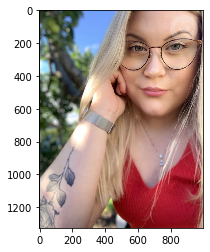

951. Blond or Other (1/0): 1


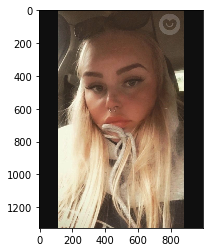

952. Blond or Other (1/0): 1


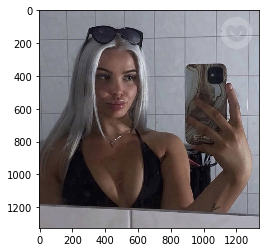

953. Blond or Other (1/0): 0


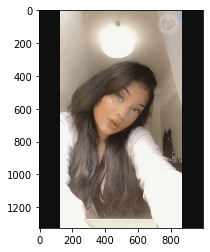

954. Blond or Other (1/0): 0


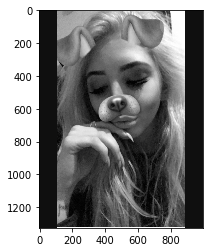

955. Blond or Other (1/0): 0


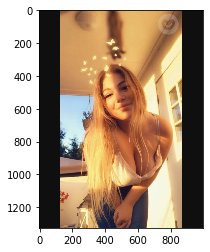

956. Blond or Other (1/0): 1


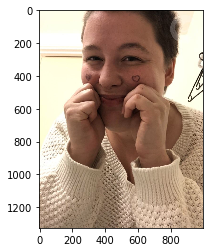

957. Blond or Other (1/0): 0


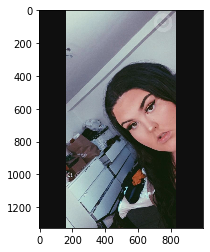

958. Blond or Other (1/0): 0


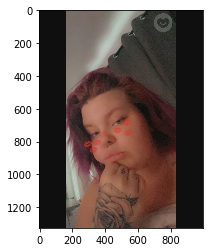

959. Blond or Other (1/0): 0


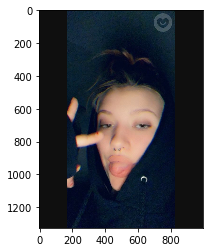

960. Blond or Other (1/0): 0


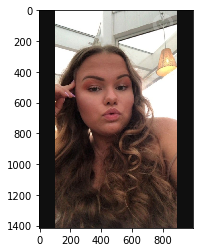

961. Blond or Other (1/0): 0


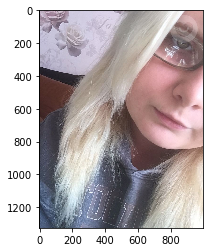

962. Blond or Other (1/0): 1


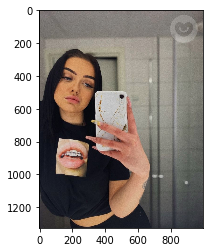

963. Blond or Other (1/0): 0


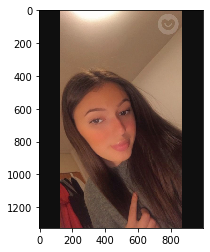

964. Blond or Other (1/0): 0


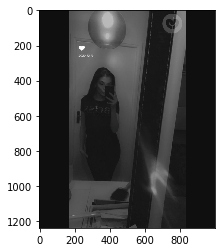

965. Blond or Other (1/0): 0


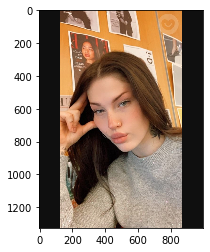

966. Blond or Other (1/0): 0


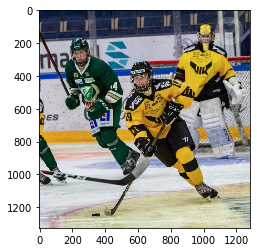

967. Blond or Other (1/0): 0


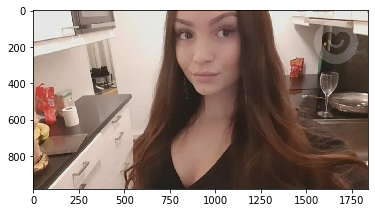

968. Blond or Other (1/0): 0


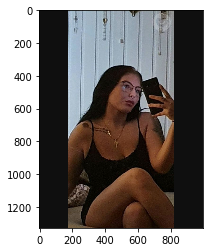

969. Blond or Other (1/0): 0


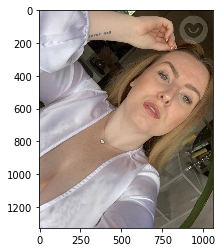

970. Blond or Other (1/0): 1


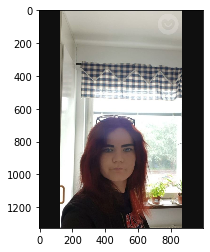

971. Blond or Other (1/0): 0


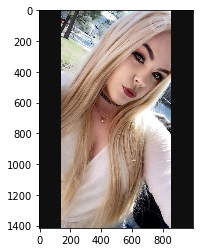

972. Blond or Other (1/0): 1


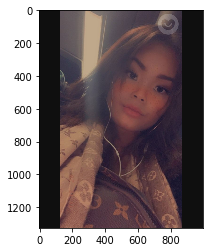

973. Blond or Other (1/0): 0


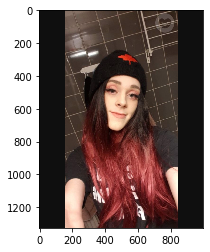

974. Blond or Other (1/0): 0


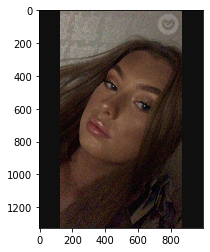

975. Blond or Other (1/0): 0


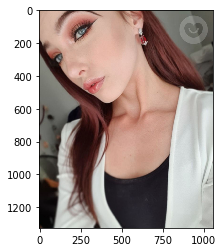

976. Blond or Other (1/0): 0


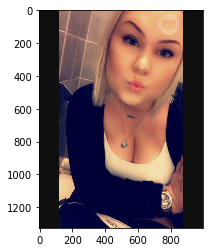

977. Blond or Other (1/0): 1


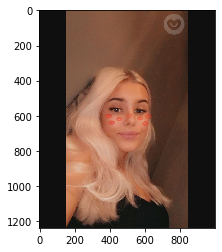

978. Blond or Other (1/0): 1


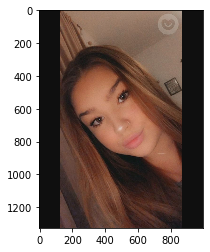

979. Blond or Other (1/0): 0


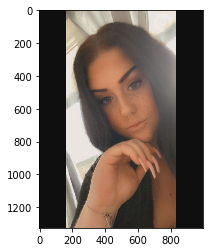

980. Blond or Other (1/0): 0


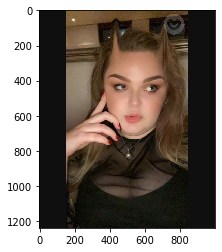

981. Blond or Other (1/0): 0


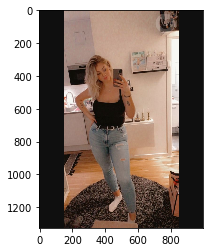

982. Blond or Other (1/0): 1


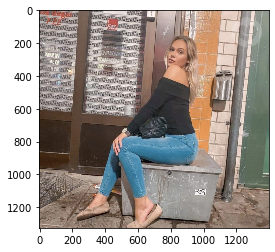

983. Blond or Other (1/0): 1


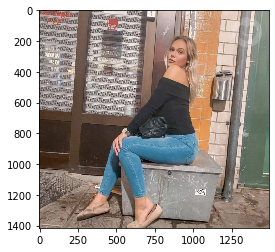

984. Blond or Other (1/0): 1


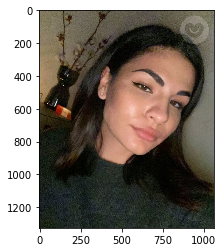

985. Blond or Other (1/0): 0


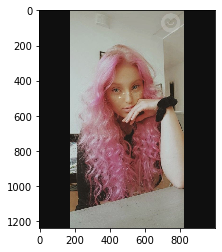

986. Blond or Other (1/0): 0


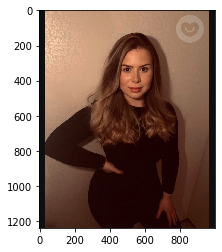

987. Blond or Other (1/0): 0


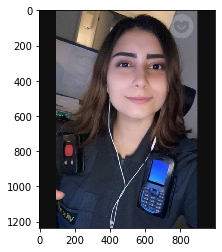

988. Blond or Other (1/0): 0


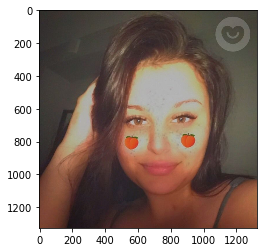

989. Blond or Other (1/0): 0


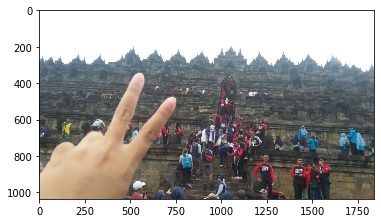

990. Blond or Other (1/0): 0


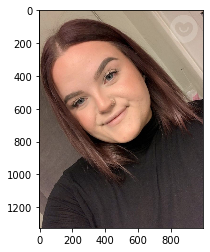

991. Blond or Other (1/0): 0


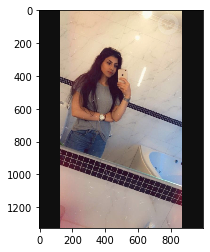

992. Blond or Other (1/0): 0


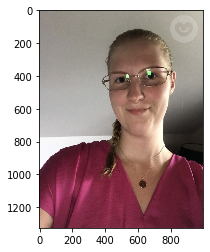

993. Blond or Other (1/0): 0


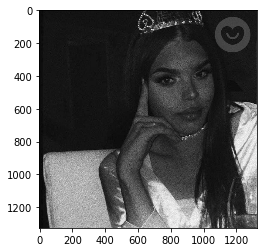

994. Blond or Other (1/0): 0


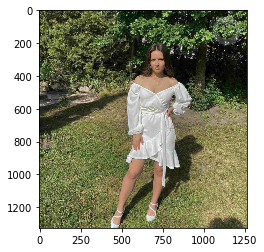

995. Blond or Other (1/0): 0


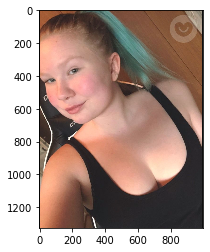

996. Blond or Other (1/0): 0


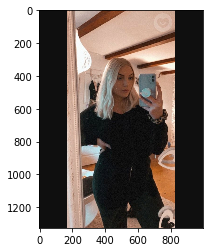

997. Blond or Other (1/0): 1


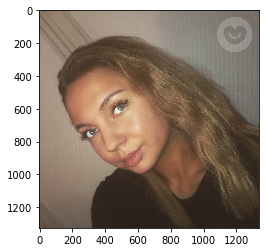

998. Blond or Other (1/0): 1


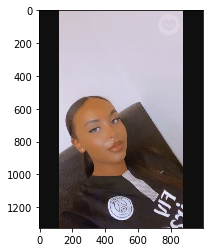

999. Blond or Other (1/0): 0


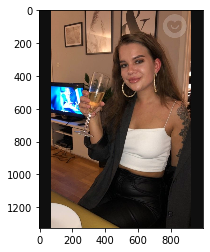

1000. Blond or Other (1/0): 0


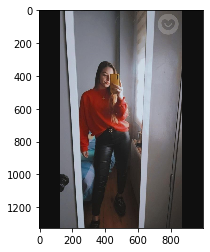

1001. Blond or Other (1/0): 0


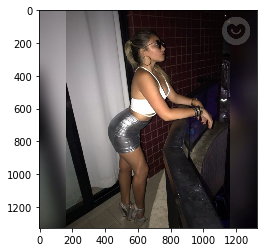

1002. Blond or Other (1/0): 0


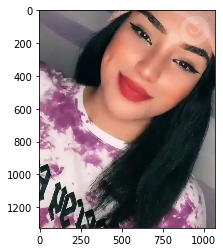

1003. Blond or Other (1/0): 0


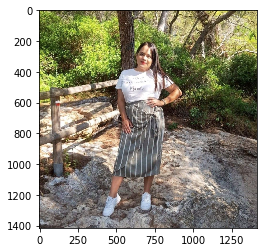

1004. Blond or Other (1/0): 0


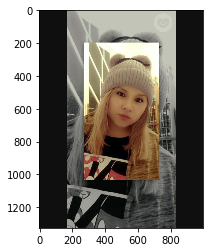

1005. Blond or Other (1/0): 1


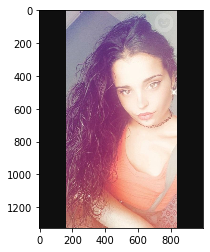

1006. Blond or Other (1/0): 0


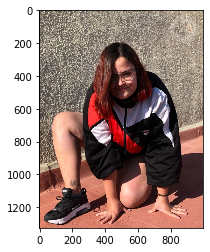

1007. Blond or Other (1/0): 0


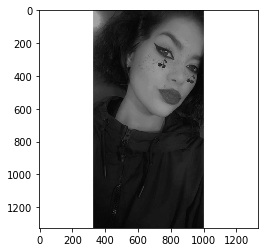

1008. Blond or Other (1/0): 0


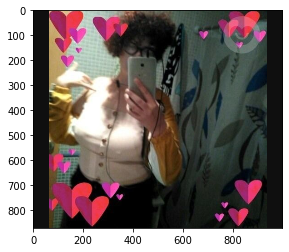

1009. Blond or Other (1/0): 0


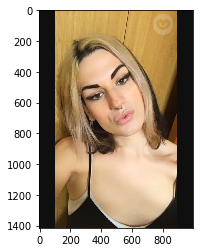

1010. Blond or Other (1/0): 1


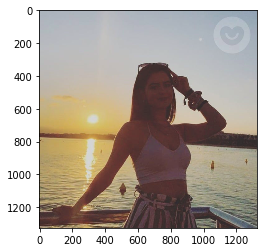

1011. Blond or Other (1/0): 0


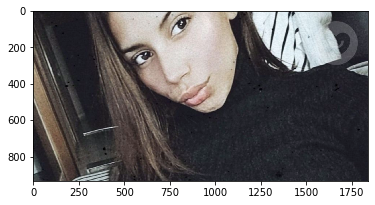

1012. Blond or Other (1/0): 0


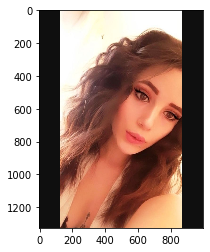

1013. Blond or Other (1/0): 0


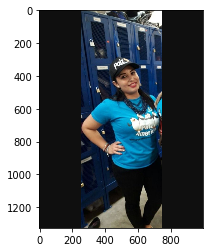

1014. Blond or Other (1/0): 0


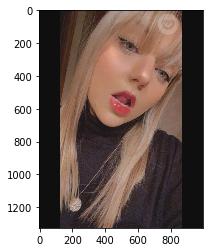

1015. Blond or Other (1/0): 1


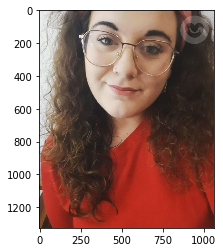

1016. Blond or Other (1/0): 0


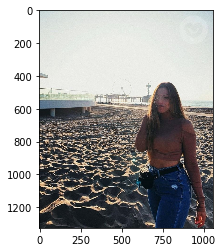

1017. Blond or Other (1/0): 0


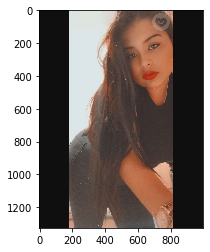

1018. Blond or Other (1/0): 0


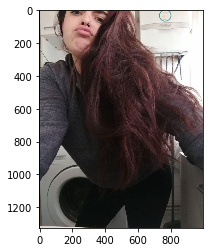

1019. Blond or Other (1/0): 0


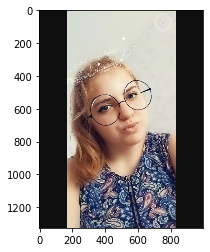

1020. Blond or Other (1/0): 1


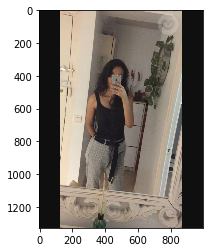

1021. Blond or Other (1/0): 0


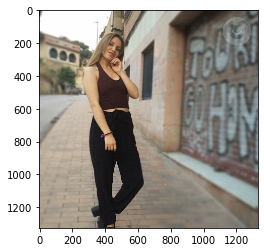

1022. Blond or Other (1/0): 0


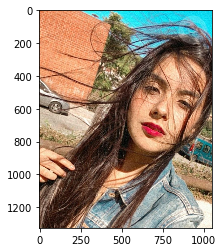

1023. Blond or Other (1/0): 0


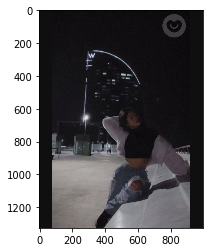

1024. Blond or Other (1/0): 0


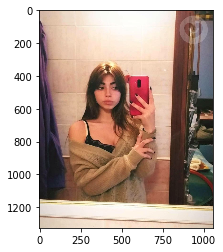

1025. Blond or Other (1/0): 0


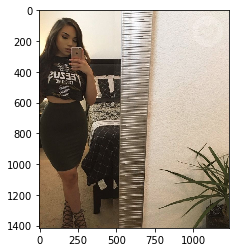

1026. Blond or Other (1/0): 0


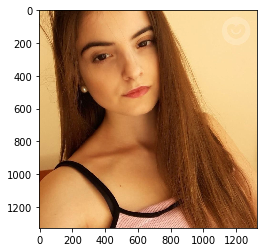

1027. Blond or Other (1/0): 0


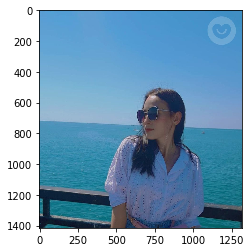

1028. Blond or Other (1/0): 0


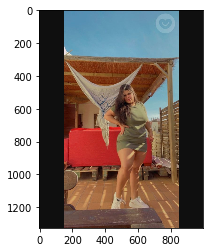

1029. Blond or Other (1/0): 0


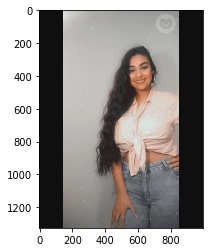

1030. Blond or Other (1/0): 0


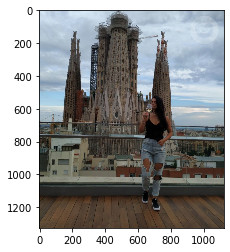

1031. Blond or Other (1/0): 0


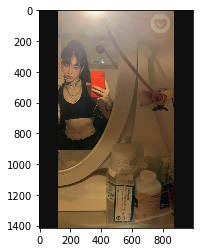

1032. Blond or Other (1/0): 0


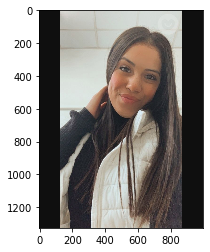

1033. Blond or Other (1/0): 0


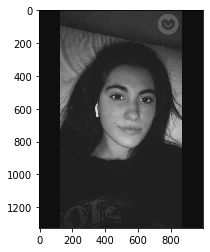

1034. Blond or Other (1/0): 0


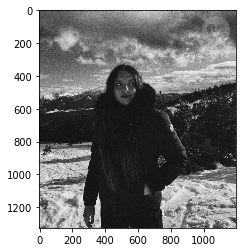

1035. Blond or Other (1/0): 0


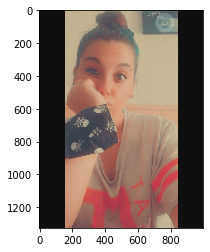

1036. Blond or Other (1/0): 0


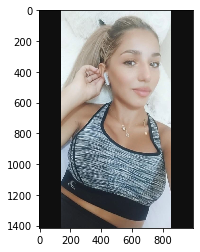

1037. Blond or Other (1/0): 1


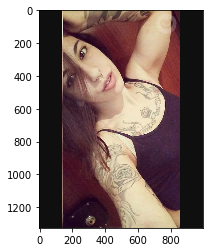

1038. Blond or Other (1/0): 0


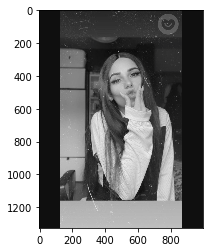

1039. Blond or Other (1/0): 0


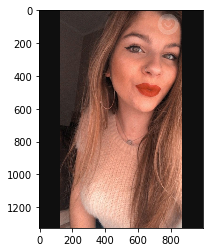

1040. Blond or Other (1/0): 1


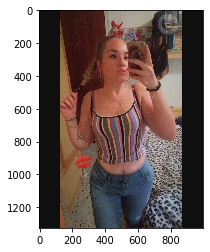

1041. Blond or Other (1/0): 0


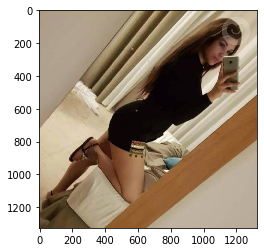

1042. Blond or Other (1/0): 0


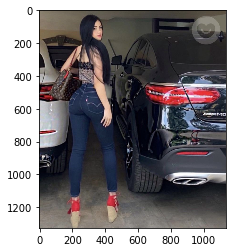

1043. Blond or Other (1/0): 0


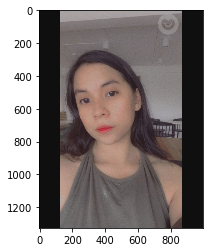

1044. Blond or Other (1/0): 0


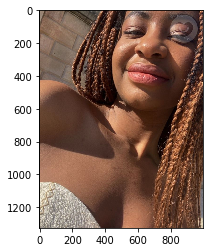

1045. Blond or Other (1/0): 0


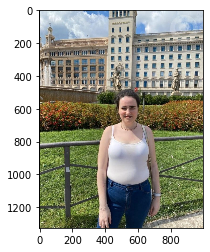

1046. Blond or Other (1/0): 0


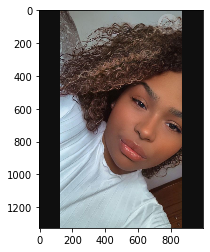

1047. Blond or Other (1/0): 0


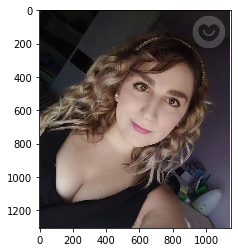

1048. Blond or Other (1/0): 1


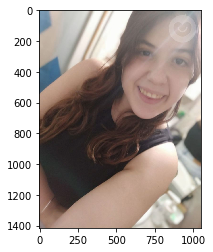

1049. Blond or Other (1/0): 0


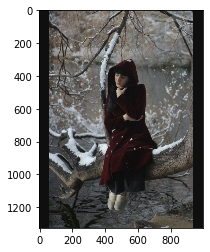

1050. Blond or Other (1/0): 0


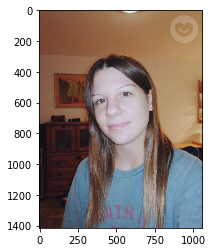

1051. Blond or Other (1/0): 0


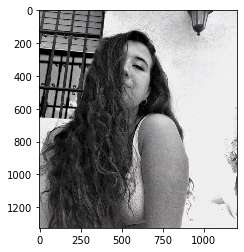

1052. Blond or Other (1/0): 0


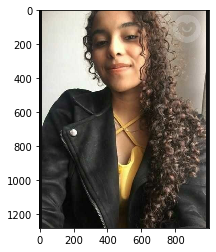

1053. Blond or Other (1/0): 0


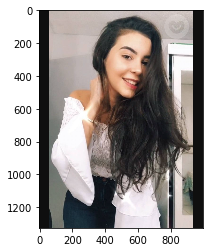

1054. Blond or Other (1/0): 0


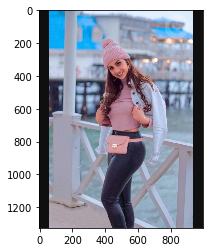

1055. Blond or Other (1/0): 0


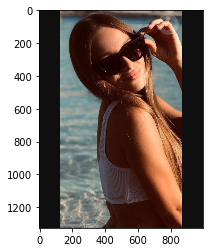

1056. Blond or Other (1/0): 0


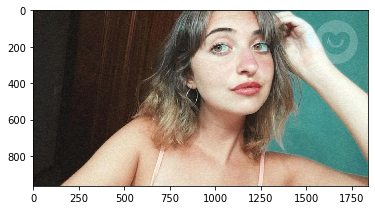

1057. Blond or Other (1/0): 1


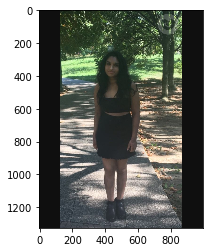

1058. Blond or Other (1/0): 0


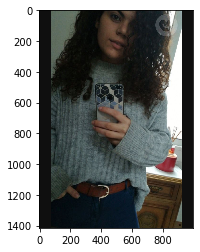

1059. Blond or Other (1/0): 0


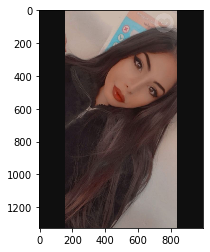

1060. Blond or Other (1/0): 0


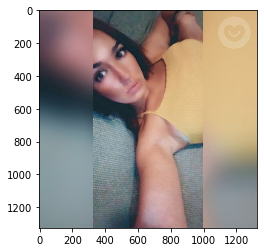

1061. Blond or Other (1/0): 0


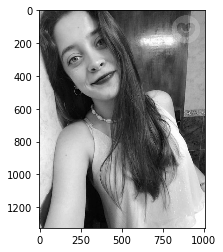

1062. Blond or Other (1/0): 0


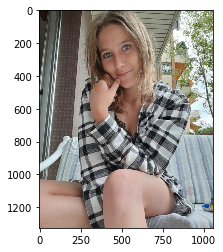

1063. Blond or Other (1/0): 1


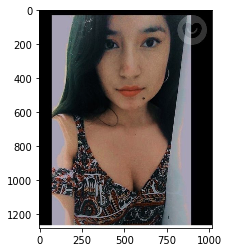

1064. Blond or Other (1/0): 0


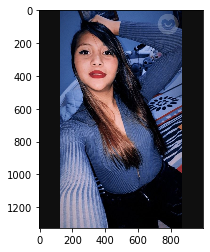

1065. Blond or Other (1/0): 0


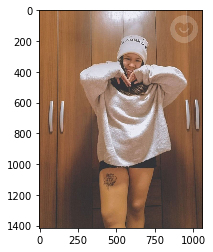

1066. Blond or Other (1/0): 0


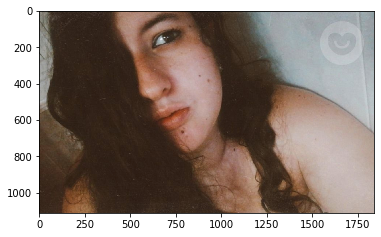

1067. Blond or Other (1/0): 0


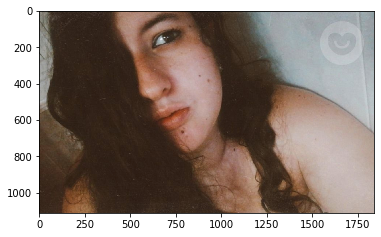

1068. Blond or Other (1/0): 0


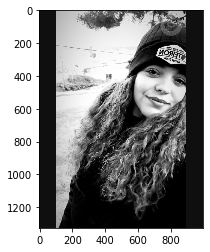

1069. Blond or Other (1/0): 0


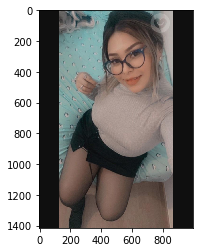

1070. Blond or Other (1/0): 0


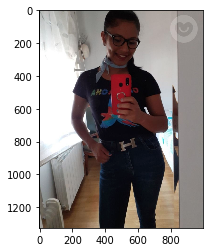

1071. Blond or Other (1/0): 0


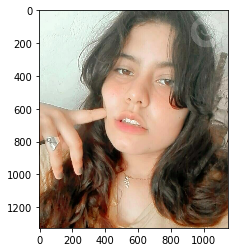

1072. Blond or Other (1/0): 0


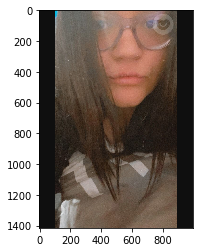

1073. Blond or Other (1/0): 0


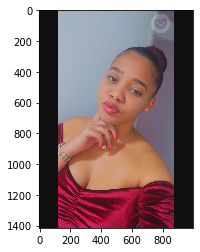

1074. Blond or Other (1/0): 0


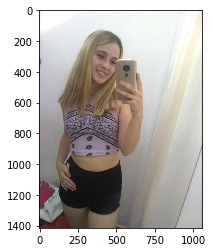

1075. Blond or Other (1/0): 1


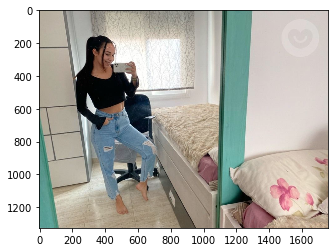

1076. Blond or Other (1/0): 0


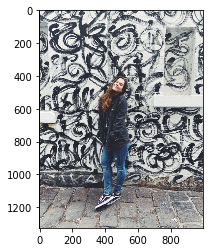

1077. Blond or Other (1/0): 0


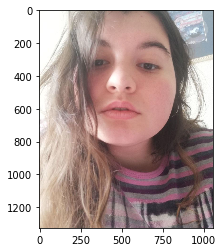

1078. Blond or Other (1/0): 0


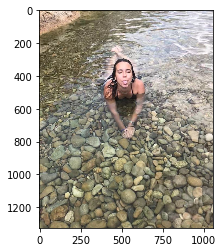

1079. Blond or Other (1/0): 0


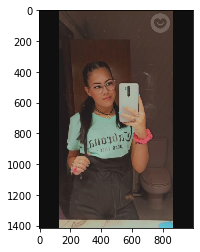

1080. Blond or Other (1/0): 0


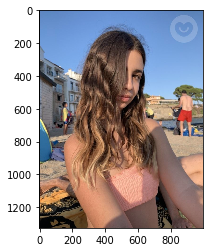

1081. Blond or Other (1/0): 0


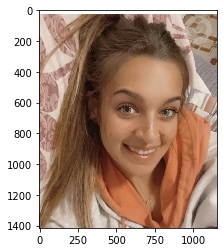

1082. Blond or Other (1/0): 1


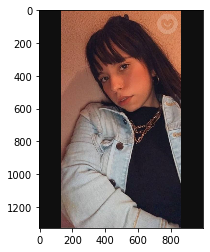

1083. Blond or Other (1/0): 0


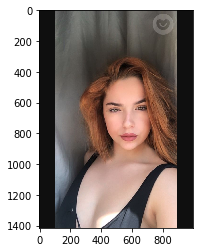

1084. Blond or Other (1/0): 0


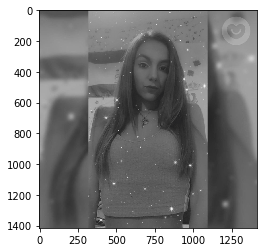

1085. Blond or Other (1/0): 0


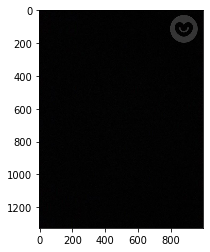

1086. Blond or Other (1/0): 0


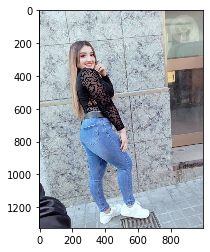

1087. Blond or Other (1/0): 0


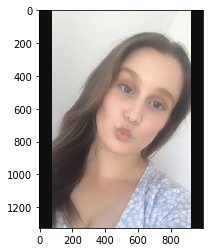

1088. Blond or Other (1/0): 0


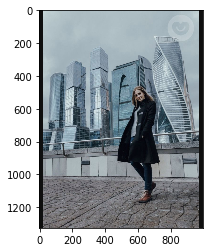

1089. Blond or Other (1/0): 0


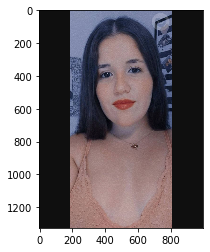

1090. Blond or Other (1/0): 0


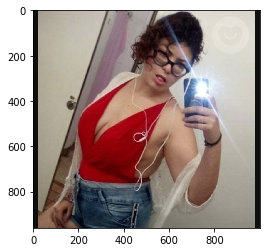

1091. Blond or Other (1/0): 0


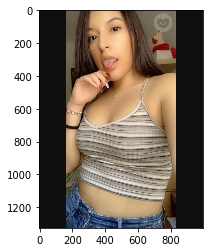

1092. Blond or Other (1/0): 0


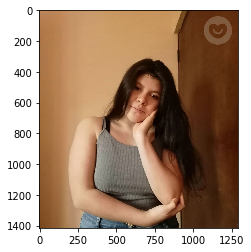

1093. Blond or Other (1/0): 0


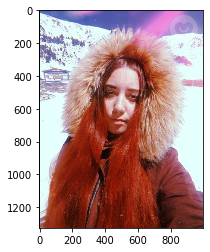

1094. Blond or Other (1/0): 0


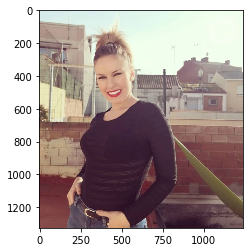

1095. Blond or Other (1/0): 0


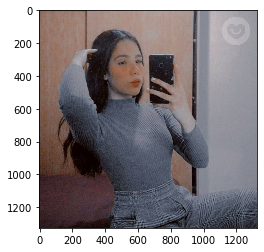

1096. Blond or Other (1/0): 0


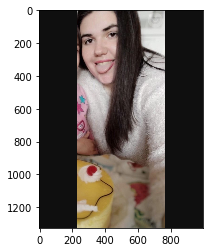

1097. Blond or Other (1/0): 0


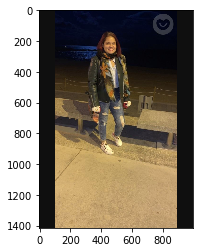

1098. Blond or Other (1/0): 0


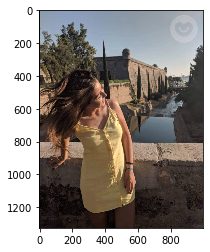

1099. Blond or Other (1/0): 0


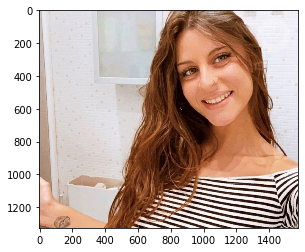

1100. Blond or Other (1/0): 0


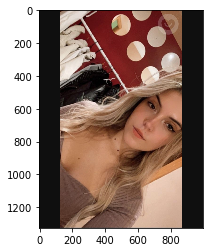

1101. Blond or Other (1/0): 1


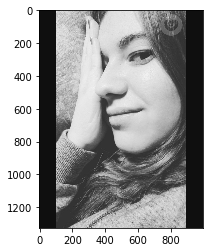

1102. Blond or Other (1/0): 0


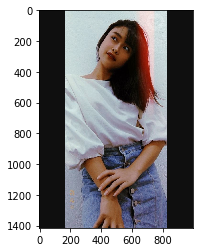

1103. Blond or Other (1/0): 0


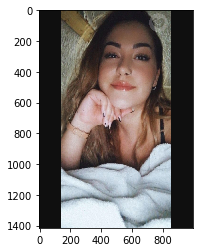

1104. Blond or Other (1/0): 0


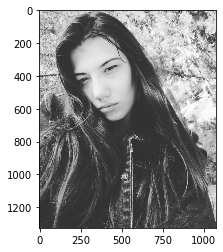

1105. Blond or Other (1/0): 0


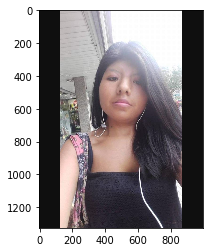

1106. Blond or Other (1/0): 0


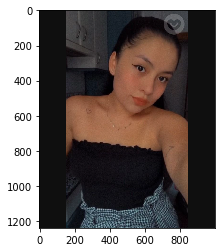

1107. Blond or Other (1/0): 0


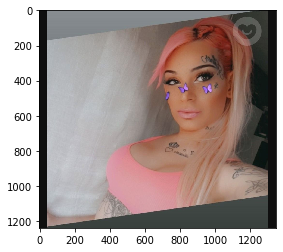

1108. Blond or Other (1/0): 1


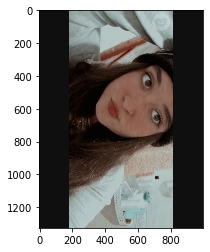

1109. Blond or Other (1/0): 0


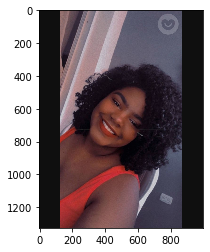

1110. Blond or Other (1/0): 0


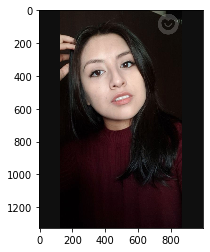

1111. Blond or Other (1/0): 0


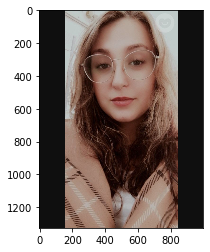

1112. Blond or Other (1/0): 1


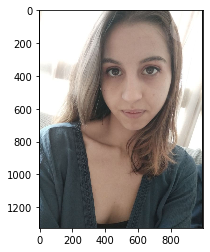

1113. Blond or Other (1/0): 0


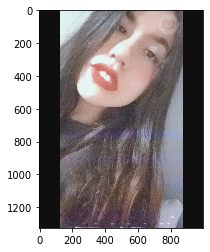

1114. Blond or Other (1/0): 0


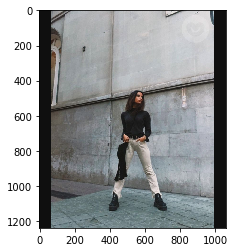

1115. Blond or Other (1/0): 0


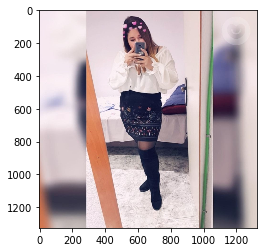

1116. Blond or Other (1/0): 0


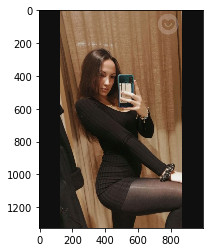

1117. Blond or Other (1/0): 0


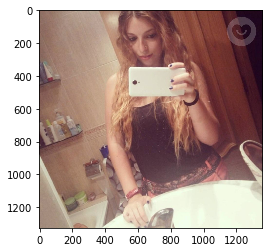

1118. Blond or Other (1/0): 1


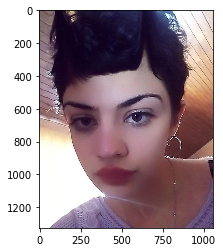

1119. Blond or Other (1/0): 0


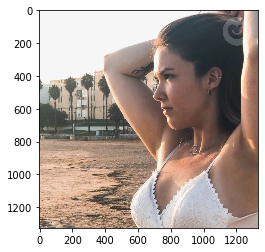

1120. Blond or Other (1/0): 0


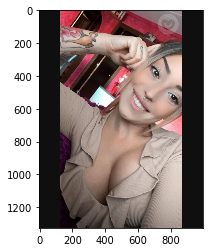

1121. Blond or Other (1/0): 0


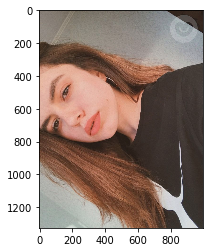

1122. Blond or Other (1/0): 0


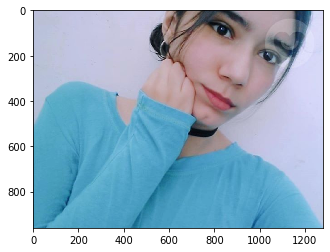

1123. Blond or Other (1/0): 0


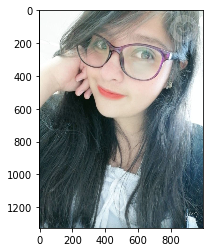

1124. Blond or Other (1/0): 0


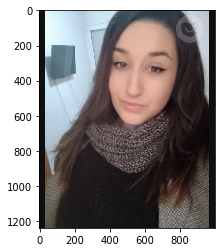

1125. Blond or Other (1/0): 0


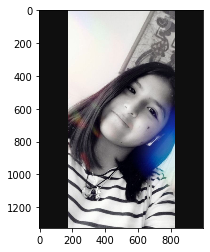

1126. Blond or Other (1/0): 0


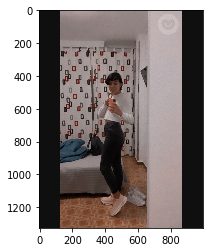

1127. Blond or Other (1/0): 0


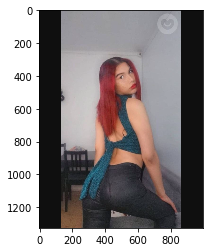

1128. Blond or Other (1/0): 0


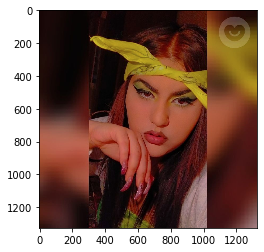

1129. Blond or Other (1/0): 0


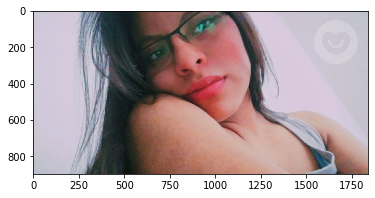

1130. Blond or Other (1/0): 0


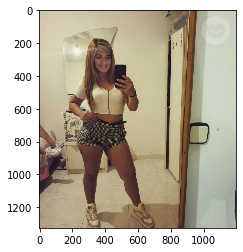

1131. Blond or Other (1/0): 0


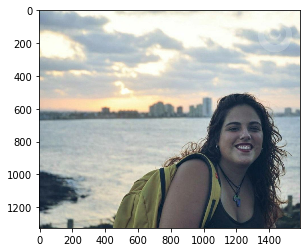

1132. Blond or Other (1/0): 0


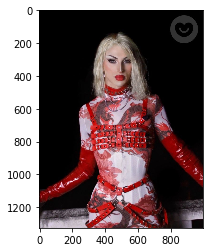

1133. Blond or Other (1/0): 1


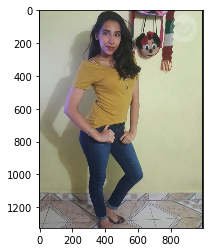

1134. Blond or Other (1/0): 0


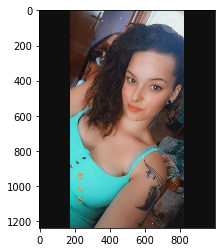

1135. Blond or Other (1/0): 0


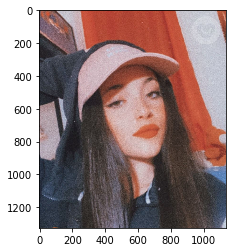

1136. Blond or Other (1/0): 0


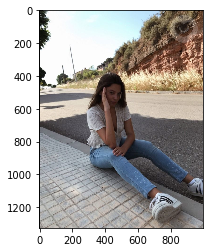

1137. Blond or Other (1/0): 0


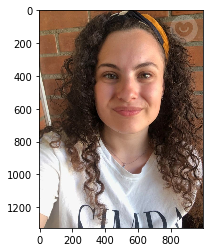

1138. Blond or Other (1/0): 0


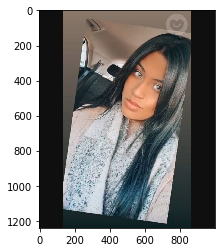

1139. Blond or Other (1/0): 0


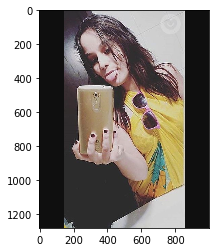

1140. Blond or Other (1/0): 0


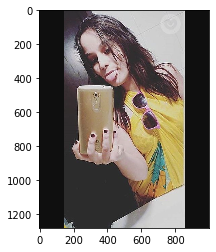

1141. Blond or Other (1/0): 0


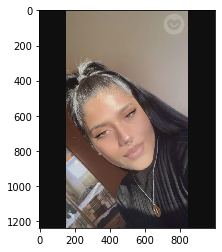

1142. Blond or Other (1/0): 0


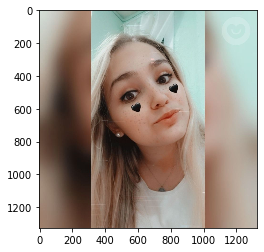

1143. Blond or Other (1/0): 1


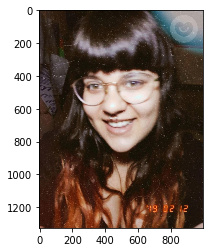

1144. Blond or Other (1/0): 0


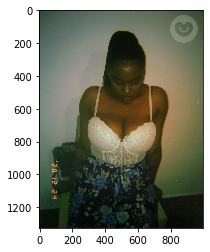

1145. Blond or Other (1/0): 0


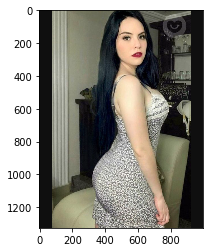

1146. Blond or Other (1/0): 0


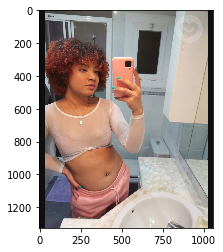

1147. Blond or Other (1/0): 0


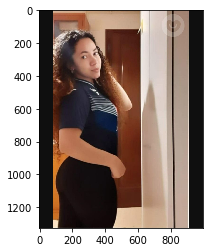

1148. Blond or Other (1/0): 0


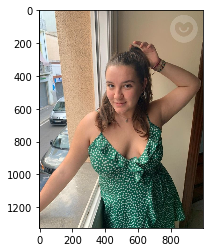

1149. Blond or Other (1/0): 0


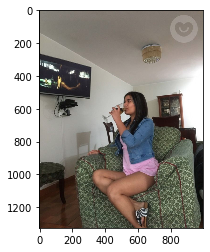

1150. Blond or Other (1/0): 0


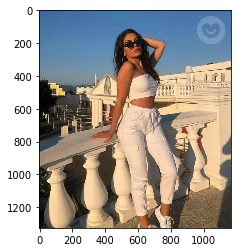

1151. Blond or Other (1/0): 0


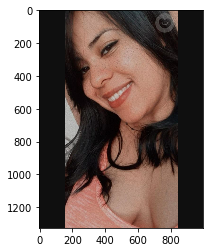

1152. Blond or Other (1/0): 0


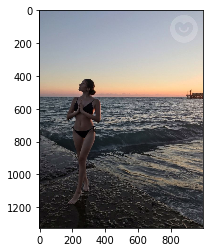

1153. Blond or Other (1/0): 0


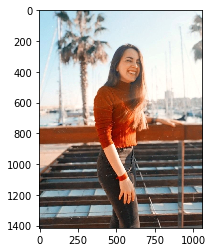

1154. Blond or Other (1/0): 0


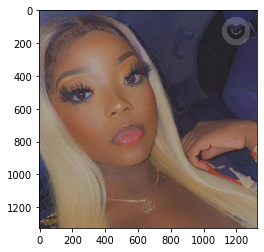

1155. Blond or Other (1/0): 1


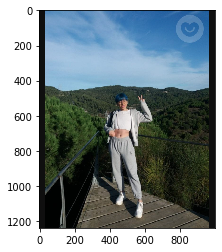

1156. Blond or Other (1/0): 0


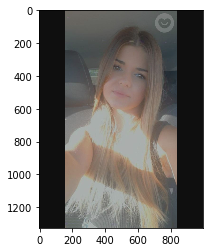

1157. Blond or Other (1/0): 1


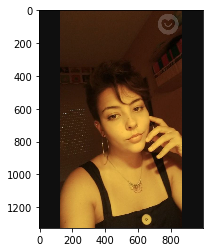

1158. Blond or Other (1/0): 0


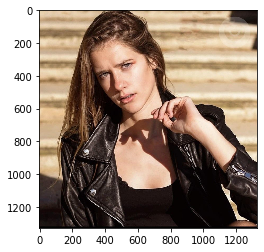

1159. Blond or Other (1/0): 0


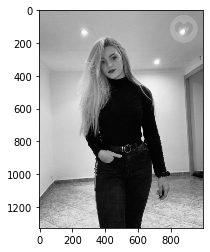

1160. Blond or Other (1/0): 0


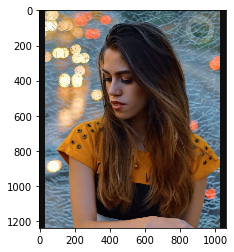

1161. Blond or Other (1/0): 0


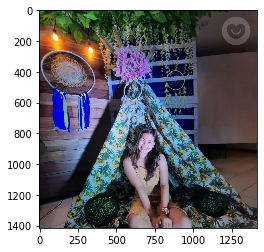

1162. Blond or Other (1/0): 0


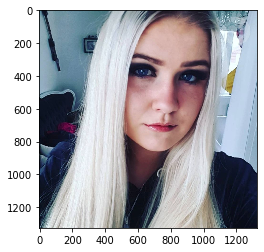

1163. Blond or Other (1/0): 1


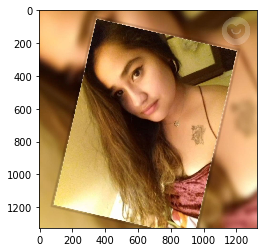

1164. Blond or Other (1/0): 0


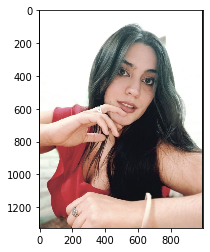

1165. Blond or Other (1/0): 0


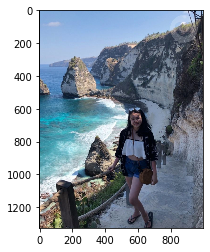

1166. Blond or Other (1/0): 0


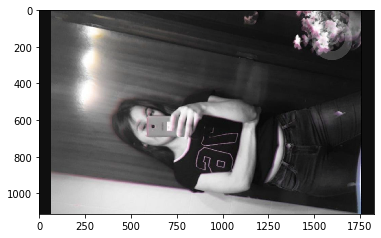

1167. Blond or Other (1/0): 0


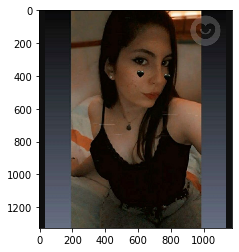

1168. Blond or Other (1/0): 0


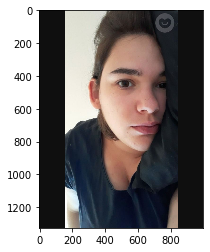

1169. Blond or Other (1/0): 0


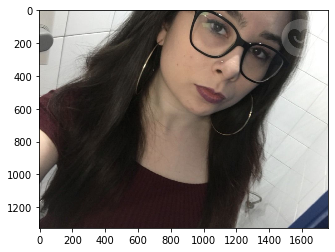

1170. Blond or Other (1/0): 0


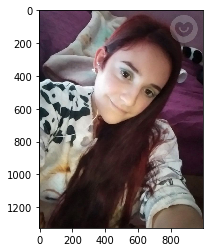

1171. Blond or Other (1/0): 0


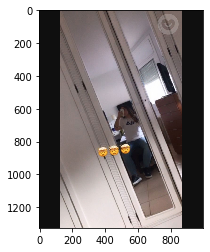

1172. Blond or Other (1/0): 0


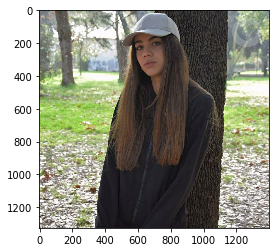

1173. Blond or Other (1/0): 0


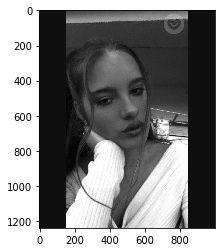

1174. Blond or Other (1/0): 0


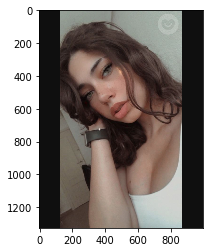

1175. Blond or Other (1/0): 0


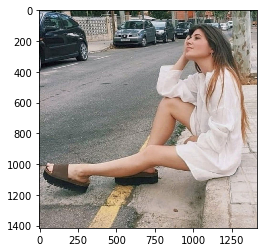

1176. Blond or Other (1/0): 0


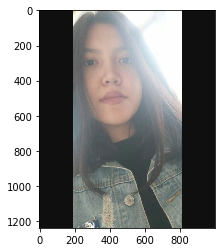

1177. Blond or Other (1/0): 0


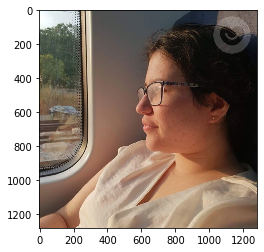

1178. Blond or Other (1/0): 0


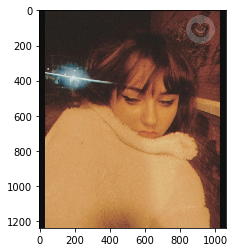

1179. Blond or Other (1/0): 0


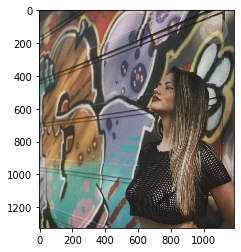

1180. Blond or Other (1/0): 0


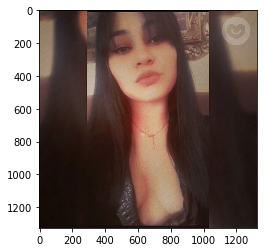

1181. Blond or Other (1/0): 0


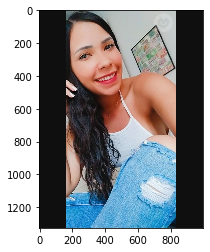

1182. Blond or Other (1/0): 0


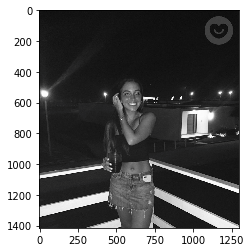

1183. Blond or Other (1/0): 0


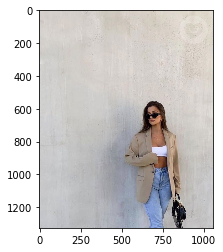

1184. Blond or Other (1/0): 0


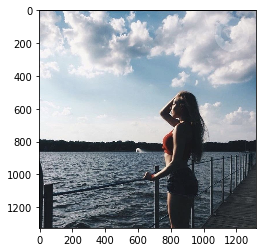

1185. Blond or Other (1/0): 0


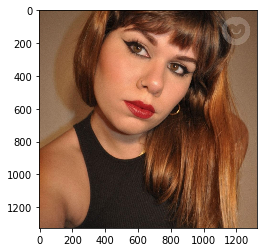

1186. Blond or Other (1/0): 0


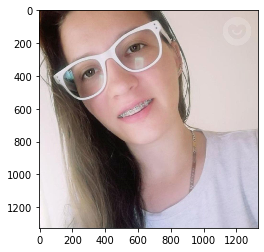

1187. Blond or Other (1/0): 0


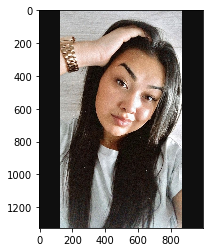

1188. Blond or Other (1/0): 0


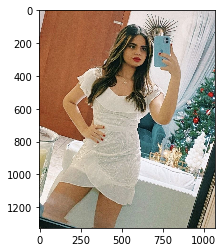

1189. Blond or Other (1/0): 0


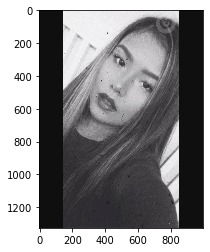

1190. Blond or Other (1/0): 0


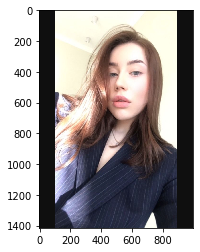

1191. Blond or Other (1/0): 0


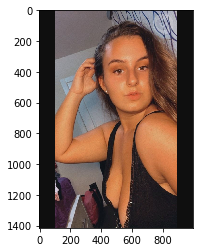

1192. Blond or Other (1/0): 0


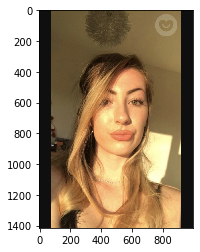

1193. Blond or Other (1/0): 1


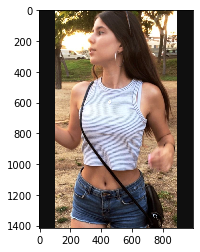

1194. Blond or Other (1/0): 0


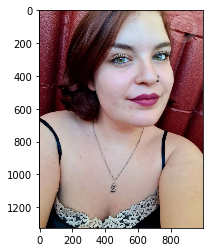

1195. Blond or Other (1/0): 0


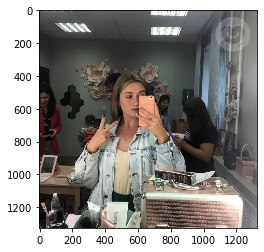

1196. Blond or Other (1/0): 1


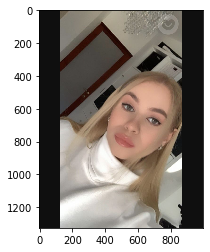

1197. Blond or Other (1/0): 1


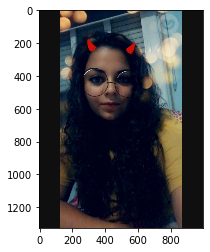

1198. Blond or Other (1/0): 0


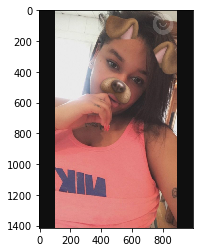

1199. Blond or Other (1/0): 0


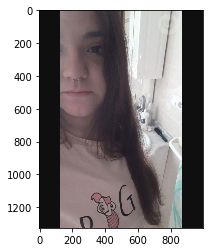

1200. Blond or Other (1/0): 0


In [149]:
folder_path = '/Users/i.p.kruyt/PycharmProjects/Badoo_Photo_Database/'
#change range to match scraped range
for i in range(951,1201):
#retrieve & show image

    try:     #define photo name
        chick_x = "photo{}.png".format(i)

            #retrieve from finder/library
        fname = folder_path + chick_x

            #show image
        img = mpimg.imread(fname)

        plt.imshow(img)
        plt.pause(0.005)

            #add label to list
        labels.append(input(f'{i}. Blond or Other (1/0): '))

            #add image to list
        images.append(fname)

    except:
        pass


In [150]:
# Update progress and find missed inputs

print(f'Progress: {len(labels)}/1200')
count = 0
for i in range(0, len(labels)):
    if labels[i] == '1':
        count+=1
    if labels[i] != '1' and labels[i]!= '0':
        print(i)
perc = (count/len(labels))*(100)
print(f'Blond: {perc}%')

print(len(images))



Progress: 1198/1200
Blond: 24.540901502504173%
1198


In [147]:

labels[834] = '0'
labels[128] = '0'


In [153]:
#Create dataframe from labeled images
df = pd.DataFrame(data = {'images_path':images, 'Blond or Other (1/0)': labels})
df.to_csv(r'/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/Train_test_dataset_v1.csv')
df.describe()

,images_path,Blond or Other (1/0)
count,1198,1198
unique,1198,2
top,/Users/i.p.kruyt/PycharmProjects/Badoo_Photo_Database/photo855.png,0
freq,1,904


In [156]:
def sort_for_image_folder(destination_hot, destination_not):
    """Puts images with label 0 in folder 0 and images with label 1 in folder 1, within our TBot Train/Test file"""


    for photo in enumerate(df['images_path']):
        
        if df.loc[photo[0],'Blond or Other (1/0)'] == '1':
            new_path = shutil.move(photo[1], (destination_hot + f'/{photo[1][54:]}'))
        else:
            new_path = shutil.move(photo[1], (destination_not + f'/{photo[1][54:]}'))


In [157]:
sort_for_image_folder('/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/1', '/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/0')

**MODEL CREATION**

In [4]:
path = '/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/'
fns = get_image_files(path)
fns

(#1198) [Path('/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/0/photo74.png'),Path('/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/0/photo60.png'),Path('/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/0/photo1114.png'),Path('/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/0/photo548.png'),Path('/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/0/photo1100.png'),Path('/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/0/photo560.png'),Path('/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/0/photo1128.png'),Path('/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/0/photo206.png'),Path('/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/0/photo574.png'),Path('/Users/i.p.kruyt/PycharmProjects/Train_Test_TBot/0/photo945.png')...]

In [5]:
#load images and labels into notebook
matches = DataBlock(blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=RandomResizedCrop(224, min_scale=0.3))


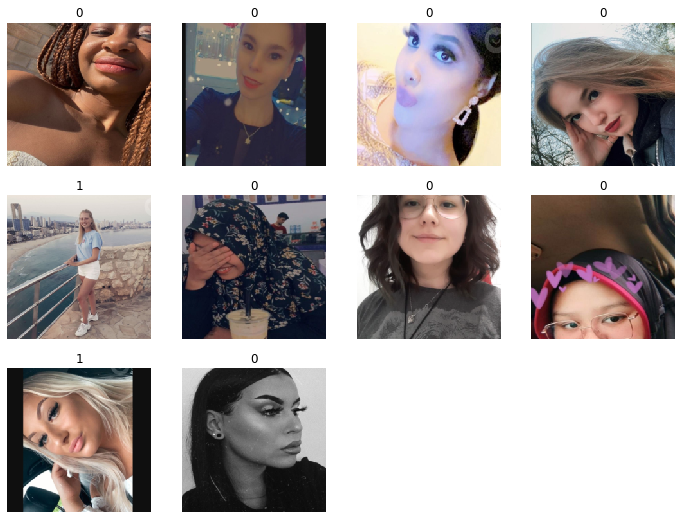

In [6]:
dls = matches.dataloaders(path)
dls.show_batch(max_n=10)

In [8]:
#create and train model
learn = cnn_learner(dls, vgg18, metrics=error_rate)
learn.fit(1)

KeyboardInterrupt: 

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [ ]:
interp.plot_top_losses(5, nrows=1)

In [ ]:
#save model and export to Python Path
learn.export()

In [ ]:
#validating export
path = Path()
path.ls(file_exts='.pkl')

**MODEL APPLICATION**

In [8]:
learn_inf = load_learner('/Users/i.p.kruyt/PycharmProjects/Tinder/TBot_model.pkl')

In [9]:
#prepare image
for y in range(0,30):
    TBot.retrieve_image('photo_to_judge')
    image_upload = SimpleNamespace(data = ['/Users/i.p.kruyt/PycharmProjects/Badoo_Photo_Database/photo_to_judge.png'])
    img = PILImage.create(image_upload.data[-1])

    #insert into model

    pred,pred_idx,probs = learn_inf.predict(img)

    print(f'Photo judgement: {pred}')
    print(f'Confidence: {probs[pred_idx]*100}%')
    if pred == '1' and probs[pred_idx]*100 > 75:
        TBot.like()
    else:
        TBot.dislike()

Photo judgement: 0
Confidence: 99.30459594726562%


Photo judgement: 0
Confidence: 93.77291107177734%


Photo judgement: 0
Confidence: 84.2101821899414%


Photo judgement: 0
Confidence: 96.06980895996094%


Photo judgement: 1
Confidence: 74.90231323242188%


Photo judgement: 0
Confidence: 97.61031341552734%


Photo judgement: 1
Confidence: 100.0%


Photo judgement: 0
Confidence: 99.32942199707031%


Photo judgement: 0
Confidence: 99.86895751953125%


Photo judgement: 0
Confidence: 97.68665313720703%


Photo judgement: 0
Confidence: 99.67616271972656%


Photo judgement: 0
Confidence: 91.54863739013672%


Photo judgement: 1
Confidence: 99.9724349975586%


Photo judgement: 0
Confidence: 99.21443176269531%


Photo judgement: 1
Confidence: 88.85867309570312%


Photo judgement: 0
Confidence: 97.170166015625%


Photo judgement: 0
Confidence: 99.83518981933594%


Photo judgement: 0
Confidence: 98.98507690429688%


Photo judgement: 1
Confidence: 99.40279388427734%


Photo judgement: 1
Confidence: 99.95600891113281%


Photo judgement: 0
Confidence: 98.70333862304688%


Photo judgement: 0
Confidence: 99.42938995361328%


Photo judgement: 0
Confidence: 99.84579467773438%


Photo judgement: 0
Confidence: 99.51827239990234%


Photo judgement: 0
Confidence: 76.86415100097656%


Photo judgement: 0
Confidence: 97.45297241210938%


Photo judgement: 1
Confidence: 100.0%


Photo judgement: 0
Confidence: 85.37947082519531%


Photo judgement: 0
Confidence: 59.47713088989258%


Photo judgement: 1
Confidence: 99.99998474121094%
